In [1]:
import os
os.chdir('../')
os.getcwd()

'/work'

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
from tqdm import tqdm

# drop_rateとn_addをoptunaで最適化する

データセット&ドメイン&サンプリングによってどれだけ結果が異なるか調査

同時にis_dynamically=Trueだった時のdrop_rateも取得しておく

In [4]:
import copy

import optuna
from plotly import tools
import plotly.graph_objects as go
from sklearn.metrics import mean_squared_error, accuracy_score, auc

In [5]:
from process.preprocess.get_dataset import get_dataset
from process.preprocess.get_set_options import get_options
from process.preprocess.turn_params import turn_params
from process.mainprocess.split_data import split_data
from process.mainprocess.models import DartForDomainAdaptation

In [6]:
class Args():
    def __init__(self, dataset, source, metrics, tune=False):
        self.dataset = dataset
        self.source = source
        self.metrics = metrics
        self.baseline = None
        self.tune = tune
        
CONFIG_DIR_UCI = './configs/experiments_uci.yml'
CONFIG_DIR_WEKA = './configs/experiments_weka.yml'

args_auto_mobile = Args("auto_mobile", "weka", "RMSE", tune=False)
args_autoMPG = Args("autoMPG", "weka", "RMSE", tune=False)
args_concrete = Args("concrete", "weka", "RMSE", tune=False)
args_housing = Args("housing", "weka", "RMSE", tune=False)
args_mushroom = Args("mushroom", "uci", "error rate", tune=False)

In [7]:
def preprocesses(args):
    options = get_options(args)
    # 提案手法のみ実行
    options["experiments"]["methods"] = ["DART for DA"]
    df = get_dataset(options["datasets"])
    if args.tune:
        options = turn_params(options, None, df, is_plot=False)
    return options, df

In [8]:
def return_metrics(y_true, y_pred, metrics):
    if metrics=="MSE":
        return mean_squared_error(y_true, y_pred)
    elif metrics=="RMSE":
        return mean_squared_error(y_true, y_pred)**0.5
    elif metrics=="accuracy":
        return accuracy_score(y_true, y_pred)
    elif metrics=="error rate":
        return 1 - accuracy_score(y_true, y_pred)
    elif metrics=="auc":
        return auc(y_true, y_pred)
    else:
        raise TypeError(f"{metrics} is illegal metrics.")
        

class Experiments(object):
    def __init__(self, options, df, target_domain, exp_round):
        X_train, y_train, X_train_target, y_train_target, \
        X_test, y_test, domain_col = split_data(options, df, target_domain, exp_round)
        
        self.X_train_source = X_train[domain_col!=target_domain]
        self.y_train_source = y_train[domain_col!=target_domain]
        self.X_train_target = X_train_target
        self.y_train_target = y_train_target
        self.X_test = X_test
        self.y_test = y_test
        self.domain_col = domain_col
        self.metrics = options["experiments"]["metrics"]
        self.model = DartForDomainAdaptation(options, "DART for DA")
        self.model.fit_source(self.X_train_source, self.y_train_source)
        
        
    def __call__(self, trial):
        params = {
            "drop_rate": trial.suggest_uniform("drop_rate", 0, 1),
            "n_estimators_add": trial.suggest_int("n_estimators_add", 0, 200),
            "is_drop_dynamically": False
        }
        return self.get_score(params)
        
        
    def get_score(self, params):
        model = copy.deepcopy(self.model)
        # update params
        model.drop_rate = params["drop_rate"]
        model.is_drop_dynamically = params["is_drop_dynamically"]
        model.n_estimators_add = params["n_estimators_add"]
        model.fit(self.X_train_target, self.y_train_target)
        pred = model.predict(self.X_test)
        
        return return_metrics(self.y_test, pred, self.metrics)
    
    def get_dynamic_drop_rate(self):
        model = copy.deepcopy(self.model)
        model.drop_rate = None
        model.is_drop_dynamically = True
        model.n_estimators_add = None
        model.fit(self.X_train_target, self.y_train_target)
        pred = model.predict(self.X_test)
        
        n_estimators = len(model.model.estimators_)
        n_dropped = sum(model.model.drop_idx)
        dynamic_drop_rate = n_dropped / n_estimators
        
        metric = return_metrics(self.y_test, pred, self.metrics)
        
        return metric, dynamic_drop_rate
        
    
    
# def get_experiments_class(options, df):
#     domains = df[options['datasets']['split_feature']].unique()

In [9]:
# options_concrete, df_concrete = preprocesses(args_concrete)

In [10]:
# experiment = Experiments(options_concrete, df_concrete, 1, 0)
# study = optuna.create_study(direction="minimize")
# study.optimize(experiment, n_trials=100)

In [11]:
# optuna.visualization.plot_contour(study)

In [12]:
# optuna.visualization.plot_slice(study)

In [13]:
# fig1.select_layout_images()

In [14]:
# from plotly import tools

# fig1 = optuna.visualization.plot_contour(study)
# fig2 = optuna.visualization.plot_slice(study)

# fig = tools.make_subplots(rows=1, cols=2)
# fig.append_trace(fig1.data[0], 1, 1)
# fig.append_trace(fig1.data[1], 1, 1)
# fig.append_trace(fig1.data[0], 1, 2)
# fig.append_trace(fig1.data[1], 1, 2)
# fig

In [15]:
# len(experiment.model.model.estimators_)

In [16]:
# experiment.model.model.get_params()

In [17]:
def main(args, target_domain):
    options, df = preprocesses(args)

    fig = tools.make_subplots(rows=3, cols=3)
    for exp_num in range(9):
        experiment = Experiments(options, df, target_domain, exp_num)
        _, dynamic_drop_rate = experiment.get_dynamic_drop_rate()
        study = optuna.create_study(direction="minimize")
        study.optimize(experiment, n_trials=100)
        fig_contour = optuna.visualization.plot_contour(study)

        drop_line = go.Scatter(x=np.full(20,dynamic_drop_rate), 
                               y=np.arange(0,200,10), 
                               line=dict(color="red",dash="dash"))
        fig.append_trace(fig_contour.data[0], 1+exp_num//3, 1+exp_num%3)
        fig.append_trace(drop_line, 1+exp_num//3, 1+exp_num%3)

    return fig

In [18]:
fig_concrete0 = main(args_concrete, 0)
fig_concrete1 = main(args_concrete, 1)
fig_concrete2 = main(args_concrete, 2)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-08-28 02:53:42,785] Trial 0 finished with value: 12.232136441112667 and parameters: {'drop_rate': 0.9939030099603344, 'n_estimators_add': 161}. Best is trial 0 with value: 12.232136441112667.
[I 2020-08-28 02:53:42,880] Trial 1 finished with value: 11.233323311644062 and parameters: {'drop_rate': 0.5642165181020902, 'n_estimators_add': 195}. Best is trial 1 with value: 11.233323311644062.
[I 2020-08-28 02:53:42,983] Trial 2 finished with value: 9.783998557544317 and parameters: {'drop_rate': 0.37964957921966347, 'n_estimators_add': 116}. Best is trial 2 with value: 9.783998557544317.
[I 2020-08-28 02:53:43,038] Trial 3 finished with value: 9.565929187591037 and parameters: {'drop_rate': 0.26773251514914287, 'n_estimators_add': 74}. Best is trial 3 with value: 9.565929187591037.
[I 2020-08-28 02:53:43,086] Tr

In [19]:
fig_auto_mobile0 = main(args_auto_mobile, 0)
fig_auto_mobile1 = main(args_auto_mobile, 1)
fig_auto_mobile2 = main(args_auto_mobile, 2)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-08-28 02:56:26,319] Trial 0 finished with value: 1698.25725922505 and parameters: {'drop_rate': 0.35737394881304074, 'n_estimators_add': 61}. Best is trial 0 with value: 1698.25725922505.
[I 2020-08-28 02:56:26,400] Trial 1 finished with value: 2248.2688764885975 and parameters: {'drop_rate': 0.9141480749399699, 'n_estimators_add': 197}. Best is trial 0 with value: 1698.25725922505.
[I 2020-08-28 02:56:26,444] Trial 2 finished with value: 1923.05050162332 and parameters: {'drop_rate': 0.6437167729936722, 'n_estimators_add': 91}. Best is trial 0 with value: 1698.25725922505.
[I 2020-08-28 02:56:26,487] Trial 3 finished with value: 1945.3473160068684 and parameters: {'drop_rate': 0.4629048735249437, 'n_estimators_add': 88}. Best is trial 0 with value: 1698.25725922505.
[I 2020-08-28 02:56:26,541] Trial 4 finis

In [20]:
fig_autoMPG0 = main(args_autoMPG, 0)
fig_autoMPG1 = main(args_autoMPG, 1)
fig_autoMPG2 = main(args_autoMPG, 2)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-08-28 02:59:16,345] Trial 0 finished with value: 4.662018378351049 and parameters: {'drop_rate': 0.22465214451099114, 'n_estimators_add': 199}. Best is trial 0 with value: 4.662018378351049.
[I 2020-08-28 02:59:16,362] Trial 1 finished with value: 4.759400696921886 and parameters: {'drop_rate': 0.3072227910034855, 'n_estimators_add': 18}. Best is trial 0 with value: 4.662018378351049.
[I 2020-08-28 02:59:16,399] Trial 2 finished with value: 3.9833008446349023 and parameters: {'drop_rate': 0.9064672370197266, 'n_estimators_add': 96}. Best is trial 2 with value: 3.9833008446349023.
[I 2020-08-28 02:59:16,410] Trial 3 finished with value: 5.717377622386733 and parameters: {'drop_rate': 0.39707212794864843, 'n_estimators_add': 1}. Best is trial 2 with value: 3.9833008446349023.
[I 2020-08-28 02:59:16,441] Trial 

In [ ]:
fig_housing0 = main(args_housing, 0)
fig_housing1 = main(args_housing, 1)
fig_housing2 = main(args_housing, 2)

/usr/local/lib/python3.7/site-packages/plotly/tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead

[I 2020-08-28 03:01:21,624] Trial 0 finished with value: 5.0034141384183775 and parameters: {'drop_rate': 0.0811595438286613, 'n_estimators_add': 166}. Best is trial 0 with value: 5.0034141384183775.
[I 2020-08-28 03:01:21,688] Trial 1 finished with value: 3.991147032920953 and parameters: {'drop_rate': 0.9027299100245899, 'n_estimators_add': 167}. Best is trial 1 with value: 3.991147032920953.
[I 2020-08-28 03:01:21,716] Trial 2 finished with value: 4.517813958624287 and parameters: {'drop_rate': 0.9392041407989339, 'n_estimators_add': 48}. Best is trial 1 with value: 3.991147032920953.
[I 2020-08-28 03:01:21,727] Trial 3 finished with value: 6.492928488755728 and parameters: {'drop_rate': 0.1615702412811345, 'n_estimators_add': 1}. Best is trial 1 with value: 3.991147032920953.
[I 2020-08-28 03:01:21,744] Trial 4 

In [22]:
fig_mushroom0 = main(args_mushroom, "e")
fig_mushroom1 = main(args_mushroom, "t")

[I 2020-08-28 03:04:09,608] Trial 80 finished with value: 0.044686336293325746 and parameters: {'drop_rate': 0.9018528771418566, 'n_estimators_add': 124}. Best is trial 2 with value: 0.044686336293325746.
[I 2020-08-28 03:04:09,721] Trial 81 finished with value: 0.044686336293325746 and parameters: {'drop_rate': 0.8402824789341883, 'n_estimators_add': 149}. Best is trial 2 with value: 0.044686336293325746.
[I 2020-08-28 03:04:09,831] Trial 82 finished with value: 0.08364365511314809 and parameters: {'drop_rate': 0.7430196519542751, 'n_estimators_add': 152}. Best is trial 2 with value: 0.044686336293325746.
[I 2020-08-28 03:04:09,888] Trial 83 finished with value: 0.044686336293325746 and parameters: {'drop_rate': 0.9527204226781633, 'n_estimators_add': 70}. Best is trial 2 with value: 0.044686336293325746.
[I 2020-08-28 03:04:09,970] Trial 84 finished with value: 0.044686336293325746 and parameters: {'drop_rate': 0.8600901067173355, 'n_estimators_add': 95}. Best is trial 2 with value: 

## concrete

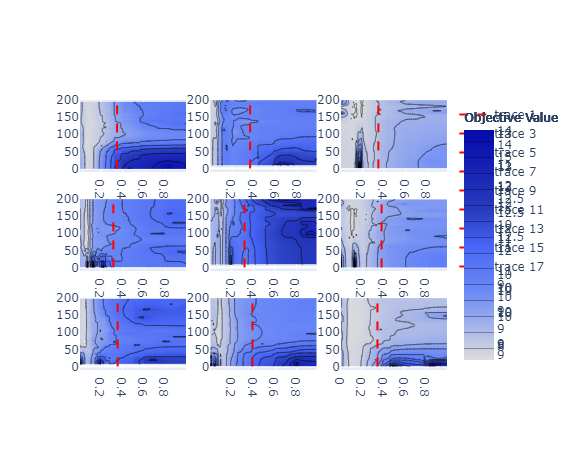

In [23]:
fig_concrete0

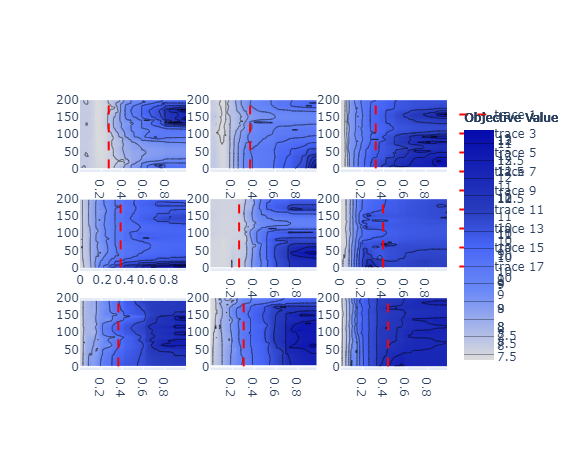

In [24]:
fig_concrete1

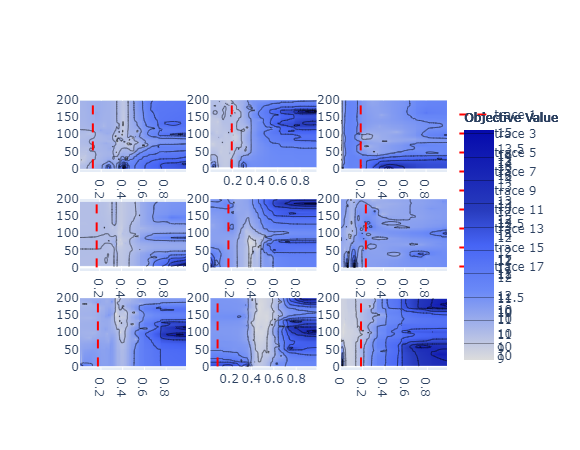

In [25]:
fig_concrete2

## auto_mobile

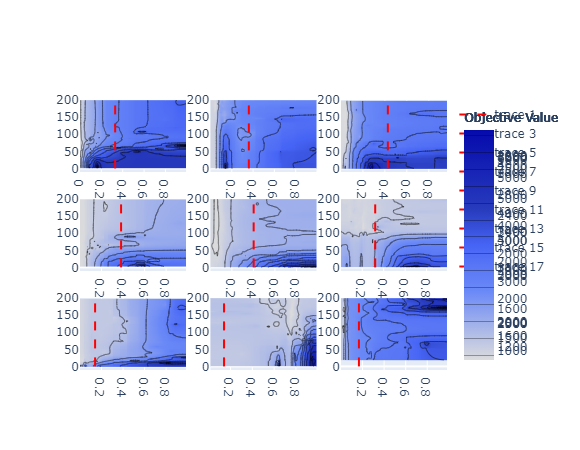

In [26]:
fig_auto_mobile0

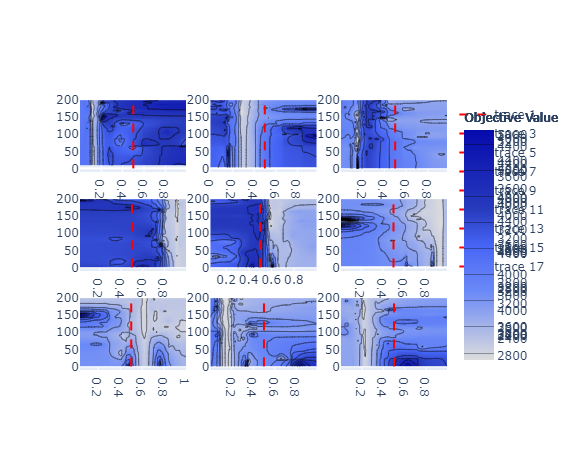

In [27]:
fig_auto_mobile1

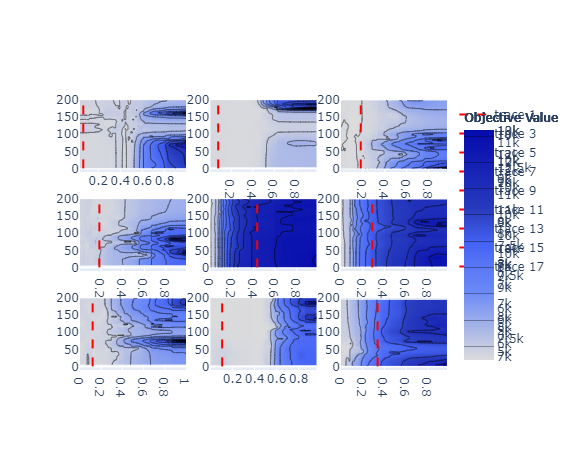

In [28]:
fig_auto_mobile2

## autoMPG

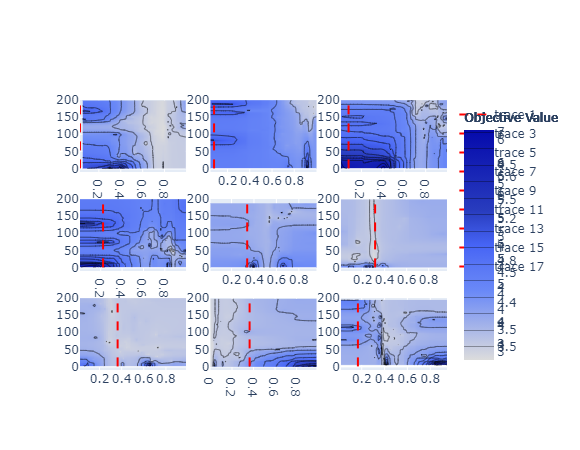

In [29]:
fig_autoMPG0

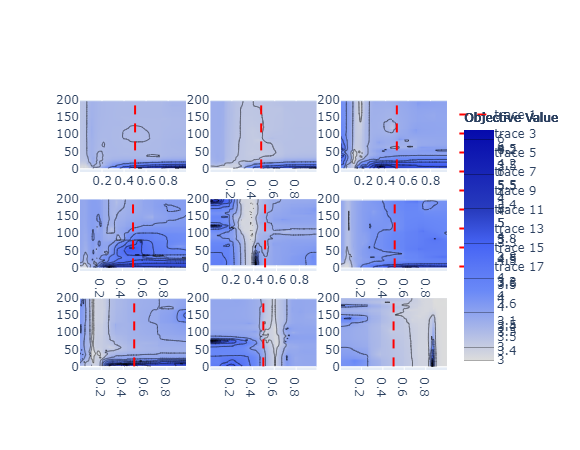

In [30]:
fig_autoMPG1

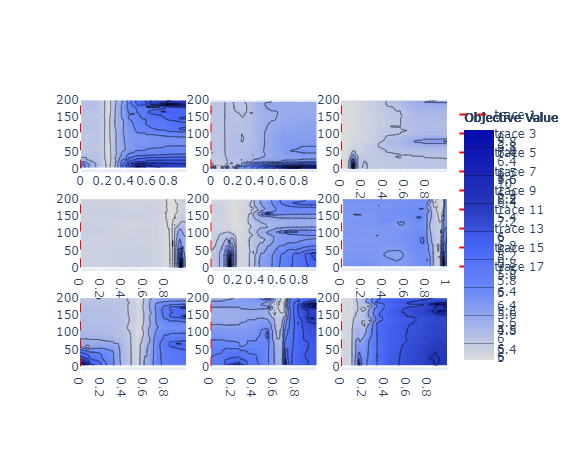

In [31]:
fig_autoMPG2

## housing

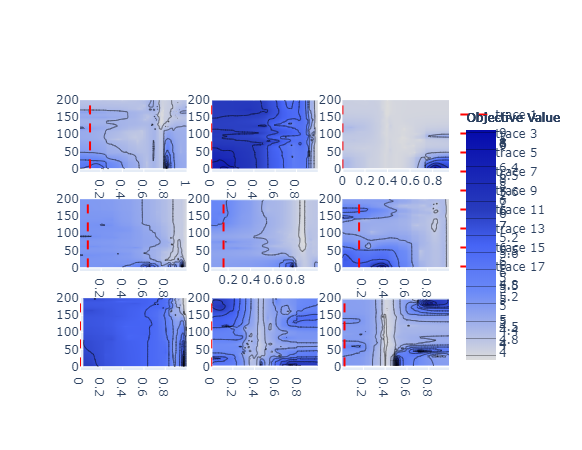

In [32]:
fig_housing0

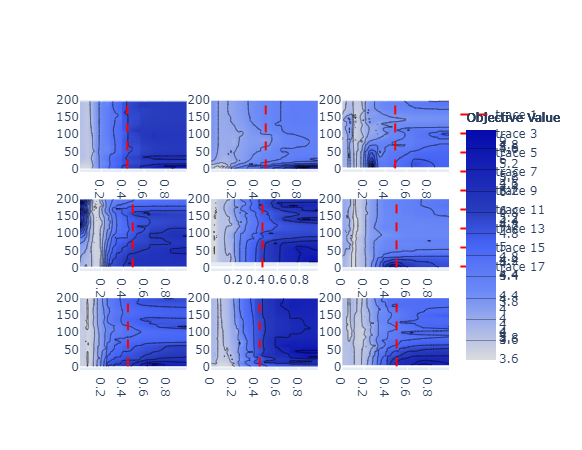

In [33]:
fig_housing1

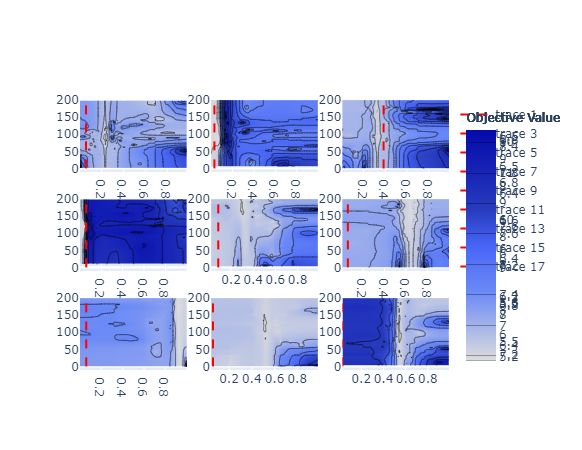

In [34]:
fig_housing2

## mushroom

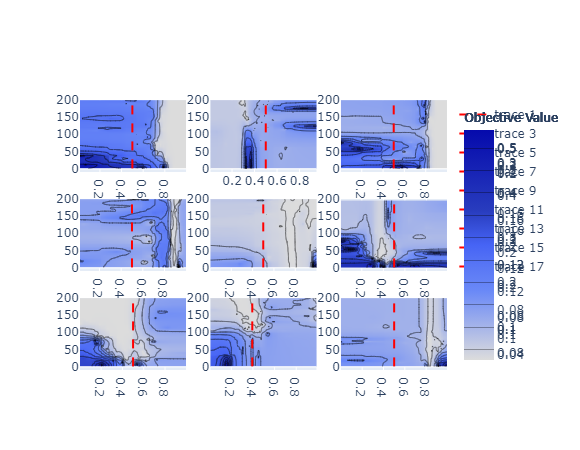

In [35]:
fig_mushroom0

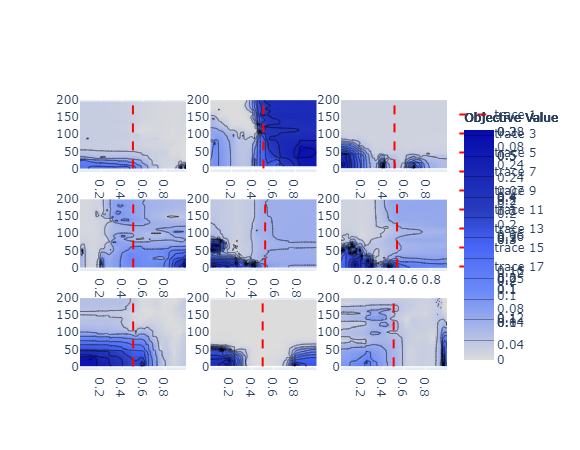

In [36]:
fig_mushroom1